
===================================================================================================

==================================================================================================

- author : Sylvie
- date   : March 7th th 2018
- update : March 13th 2018 
- Version. : 1.0

# Initialisation of the notebook

In [1]:
from IPython.core.display import HTML
def css_styling():
    styles = open("../../styles/custom.css", "r").read()
    return HTML(styles)
css_styling()

In [2]:
theNotebook="FindCentralStarPosition"

In [3]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

print theNotebook
from IPython.display import Image, display
import sys
sys.path.append("../../common_tools/")
from common_notebook import *

init_notebook()

FindCentralStarPosition
ccdproc version 1.2.0
bottleneck version 1.2.1
/Users/dagoret/MacOSX/GitHub/LSST/CTIOAnaJun2017/CTIOAnaJun2017/ana_06jun17/CheckTargetPosition


In [4]:
from astropy.modeling import models, fitting

In [5]:
import pandas as pd

In [6]:
plt.rcParams.update({'figure.max_open_warning': 0})

## Input directory

- specify which are the input images

In [7]:
inputdir="/Volumes/LaCie2/CTIODataJune2017_reducedRed/data_06jun17/"
MIN_IMGNUMBER=10
MAX_IMGNUMBER=130
date="20170606"
object_name='HD111980'
tag = "reduc"
SelectTagRe='^%s_%s_([0-9]+).fits$' % (tag,date) # regular expression to select the file
SearchTagRe='^%s_%s_[0-9]+.fits$' % (tag,date)
NBIMGPERROW=2

## Output directory

- specify where are stored the cut images as well as the plot produced

In [8]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images
ensure_dir(dir_top_images) # create that directory

outputdir="./Centr_fitsimages"
ensure_dir(outputdir)

## End of mandatory initialisation

-------------------------------------------------------
# Now  skip to the section to be re-run
-------------------------------------------------------


- Section 1: Find the central star and cut the image around the the dispersed spectrum
- Section 2 : find the dispersion axis angle of rotation wrt X-axis and apply the rotation
- Section 3 : Check with 1D spectrum

# Section 1 : Find the central star and cut the image around the the dispersed spectrum

## Read of the image spectra

In [9]:
dirlist_all = [inputdir] # only one directory to process
sorted_numbers,sorted_files = MakeFileList(dirlist_all,MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 
all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt,all_filt1,all_filt2=BuildImages(sorted_files,sorted_numbers,object_name)
print 'Number of images:',len(all_images)

Number of images: 121


## Sort the index according the disperser type



### tabulated disperser-filters

- in common_notebook

In [10]:
print Filt_names

['dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron200', 'Unknown']


### filter-disperser in our data

- check the filter names are inside Filt_names

In [11]:
print all_filt

['dia HoloPhP', 'dia HoloPhAg', 'dia HoloPhAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia Ho

In [12]:
print all_filt1

['dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia']


In [13]:
print all_filt2

['HoloPhP', 'HoloPhAg', 'HoloPhAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg'

###  Do the disperser sorting



In [14]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx=get_filt_idx(all_filt)

### Check the sorting result

In [15]:
print  Filt_names[0],' \t : filt0_idx :: ',filt0_idx
print  Filt_names[1],' \t : filt1_idx :: ',filt1_idx
print  Filt_names[2],' \t : filt2_idx :: ',filt2_idx
print  Filt_names[3],' \t : filt3_idx :: ',filt3_idx
print  Filt_names[4],' \t : filt4_idx :: ',filt4_idx
print  Filt_names[5],' \t : filt5_idx :: ',filt5_idx
print  Filt_names[6],' \t : filt6_idx :: ',filt6_idx

dia Ron400  	 : filt0_idx ::  []
dia Thor300  	 : filt1_idx ::  [  3   7  11  15  19  23  27  31  35  39  43  47  51  55  59  63  67  71
  75  79  83  87  91  95  99 103 107 111 115 119]
dia HoloPhP  	 : filt2_idx ::  [  0   4   8  12  16  20  24  28  32  36  40  44  48  52  56  60  64  68
  72  76  80  84  88  92  96 100 104 108 112 116 120]
dia HoloPhAg  	 : filt3_idx ::  [  1   2   5   9  13  17  21  25  29  33  37  41  45  49  53  57  61  65
  69  73  77  81  85  89  93  97 101 105 109 113 117]
dia HoloAmAg  	 : filt4_idx ::  [  6  10  14  18  22  26  30  34  38  42  46  50  54  58  62  66  70  74
  78  82  86  90  94  98 102 106 110 114 118]
dia Ron200  	 : filt5_idx ::  []
Unknown  	 : filt6_idx ::  []


## Example for one raw image


- the idea is to check where is the center of the main star
- size 2k x 2 K

In [16]:
# select the index
sel_index=0

Text(1000,1700,'dia HoloPhP')

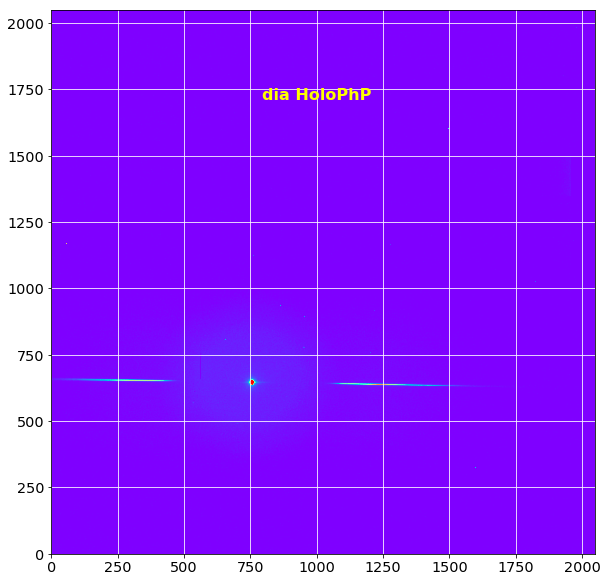

In [17]:
plt.figure(figsize=(10,10))
plt.imshow(all_images[sel_index],origin='lower',cmap='rainbow',vmin=0, vmax=2000)
plt.grid(color='white', ls='solid')
plt.text(1000.,1700,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

### Try to fit a 2D gaussian

- Fit a 2D gaussian on intensity of central star


we have to play with the parameter below to find a common region to find the central star

### Write initial guess

In [18]:
X_c_hand=800
Y_c_hand=610
Xc_min=X_c_hand-100
Xc_max=X_c_hand+100
Yc_min=Y_c_hand-100
Yc_max=Y_c_hand+100

In [19]:
# first rough estimate of the maximum
x0,y0=guess_init_fit(all_images[sel_index],Xc_min,Xc_max,Yc_min,Yc_max)

In [20]:
dw=200  # width

In [21]:
print "x0,y0=",x0,y0

x0,y0= 756 646


In [22]:
# cut the subimage
cropped_image=np.copy(all_images[sel_index][y0-dw:y0+dw,x0-dw:x0+dw])

In [23]:
NY=cropped_image.shape[0]
NX=cropped_image.shape[1]

In [24]:
# build a mesh grid of x-y
y, x = np.mgrid[:NY,:NX]

In [25]:
z=cropped_image[y,x]

### Show the pre-selected subimage

Text(100,100,'dia HoloPhP')

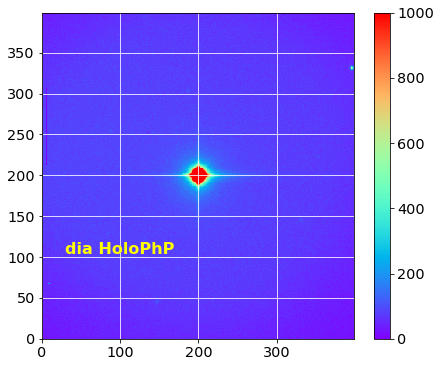

In [26]:
# plot x,y,z
plt.figure(figsize=(7,6))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

In [27]:
x_mean=NX/2
y_mean=NY/2
z_max=z[y_mean,x_mean]
print x_mean,y_mean,z_max

200 200 59970.0409867


### Make the 2D fit

In [28]:
p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
fit_p = fitting.LevMarLSQFitter()

In [29]:
import warnings
p = fit_p(p_init, x, y, z)

In [30]:
print p.x_mean
print p.y_mean
print p.amplitude

Parameter('x_mean', value=199.906413261)
Parameter('y_mean', value=199.923284781)
Parameter('amplitude', value=79769.8869921)


In [31]:
new_x0=p.x_mean
new_y0=p.y_mean

### Show result of 2D gaussian fit

Text(0.5,1,'Residual')

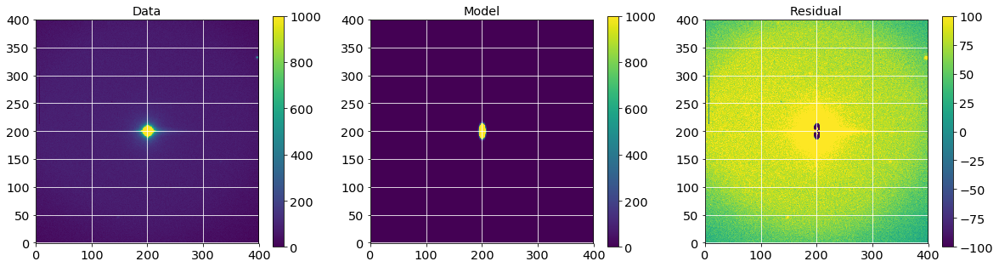

In [32]:
plt.figure(figsize=(20, 5))
#subplot 1
plt.subplot(1, 3, 1)
plt.imshow(z, origin='lower', interpolation='nearest', vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Data")
#subplot 2
plt.subplot(1, 3, 2)
plt.imshow(p(x, y), origin='lower', interpolation='nearest', vmin=0,vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Model")
#subplot 3
plt.subplot(1, 3, 3)
plt.imshow(z - p(x, y), origin='lower', interpolation='nearest', vmin=-100,vmax=100)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Residual")

### Check the result of the fit

- the center of the star is where it is expected (black point)

Text(100,100,'dia HoloPhP')

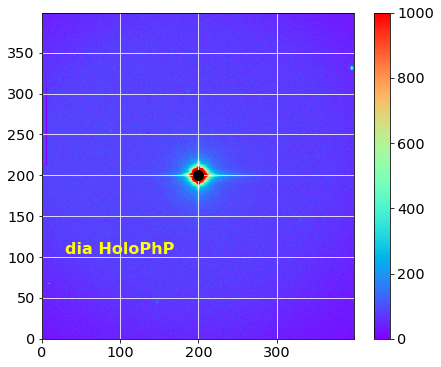

In [33]:
plt.figure(figsize=(7,6))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.plot([new_x0],[new_y0],'ko',markersize=10)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

## Show the images at Input

- So now work on the series of the images

- First look at them
- notice there is a downsampling factor of 10

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

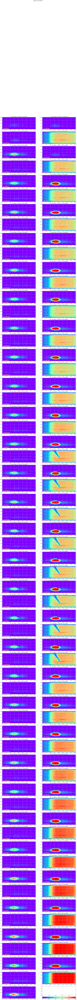

In [34]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=1000,downsampling=10,verbose=True)
figfilename=os.path.join(dir_top_images,'input_images.pdf')
plt.savefig(figfilename)   

## Show the histograms of input images

- just check the reduction and deflattage is OK

In [35]:
#ShowHistograms(all_images,all_titles,all_filt,object_name,
#               NBIMGPERROW=2,bins=100,range=(-50,10000),downsampling=10,verbose=True)

##  Guess central position of the central star in original image

- defines two utility functions


### Compute the position of central star

** Please the the area for the central star here **

- This is very important to predefine here the region where you expect the order 0 bright central star.
- Check below if the pre-selection allow to target the right bright star

In [36]:
# guess the region where the maximum is
#Delta_x0=[750,1000]
#Delta_y0=[500,750]
#dwc=125

#Delta_x0=[500,1100]
#Delta_y0=[500,1100]
#dwc=200

Delta_x0=[Xc_min,Xc_max]
Delta_y0=[Yc_min,Yc_max]
dwc=200


x_guess,y_guess=guess_central_position(all_images,Delta_x0,Delta_y0,dwc,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx)

0 : (x_guess,y_guess)= 755.906413261 645.923284781
1 : (x_guess,y_guess)= 757.261470881 646.442916723
2 : (x_guess,y_guess)= 846.539623711 587.829117681
3 : (x_guess,y_guess)= 755.378417554 648.185809834
4 : (x_guess,y_guess)= 754.569399158 643.519398419
5 : (x_guess,y_guess)= 845.700961989 586.335700724
6 : (x_guess,y_guess)= 843.821050067 586.002313814
7 : (x_guess,y_guess)= 754.966072947 646.230127394
8 : (x_guess,y_guess)= 754.993978949 643.615857586
9 : (x_guess,y_guess)= 843.836562181 585.893074912
10 : (x_guess,y_guess)= 843.032639939 585.106167424
11 : (x_guess,y_guess)= 753.634118627 644.834033855
12 : (x_guess,y_guess)= 753.171940217 642.590114862
13 : (x_guess,y_guess)= 842.889527455 587.616256542
14 : (x_guess,y_guess)= 841.580694131 583.93079936
15 : (x_guess,y_guess)= 750.879601115 644.082908206
16 : (x_guess,y_guess)= 750.79346459 641.46295677
17 : (x_guess,y_guess)= 841.222210899 584.591302231
18 : (x_guess,y_guess)= 840.198404806 582.399600531
19 : (x_guess,y_guess)= 7

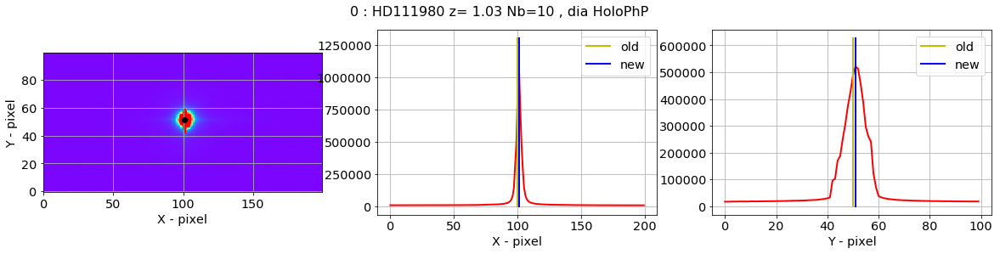

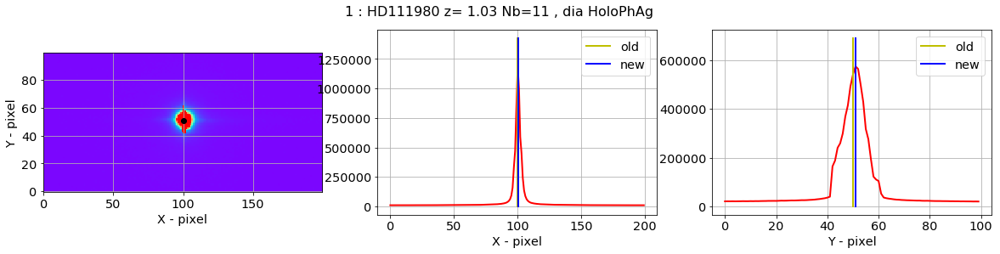

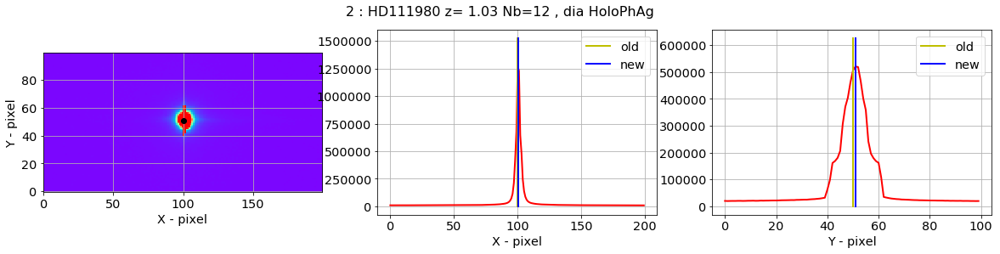

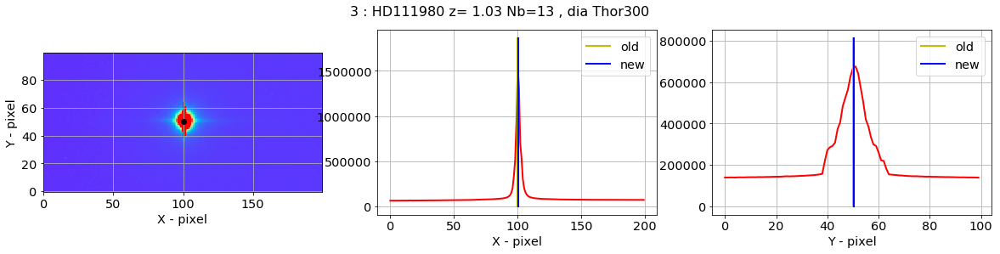

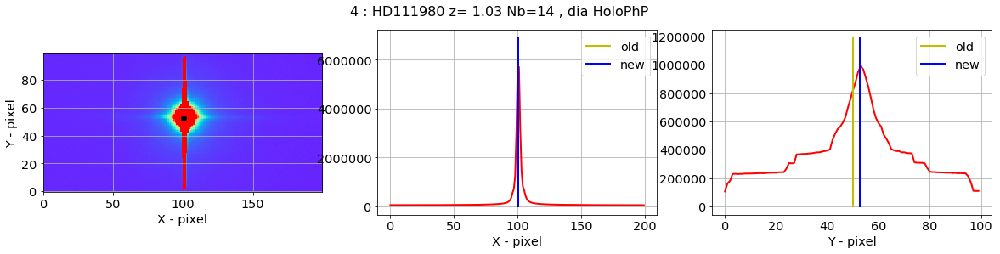

...

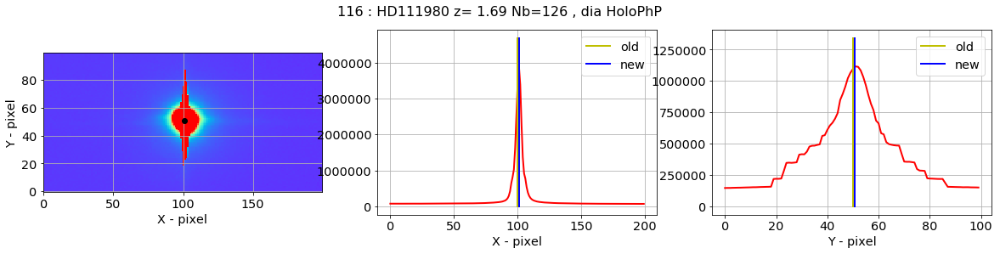

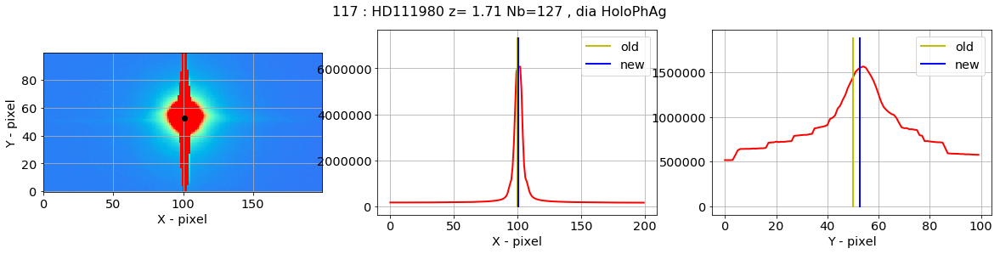

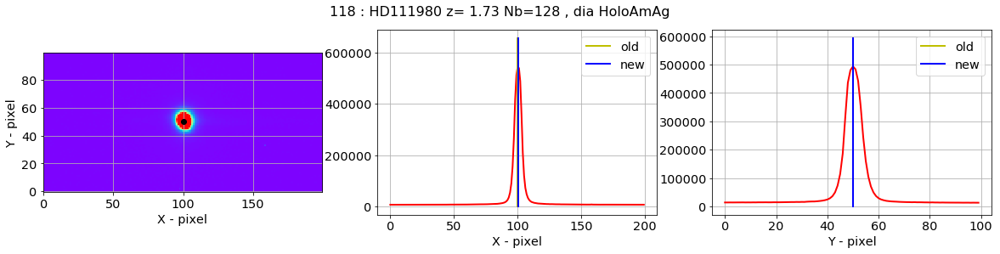

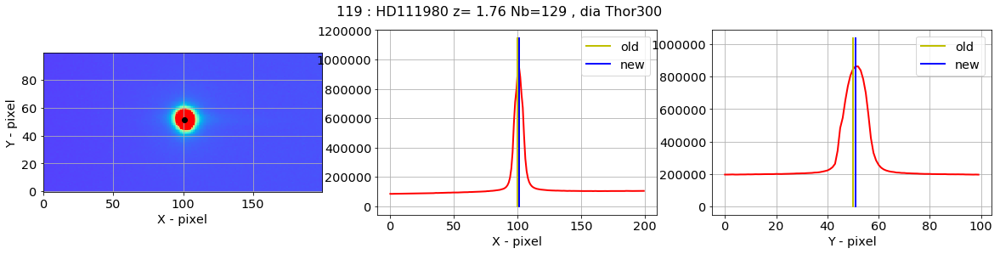

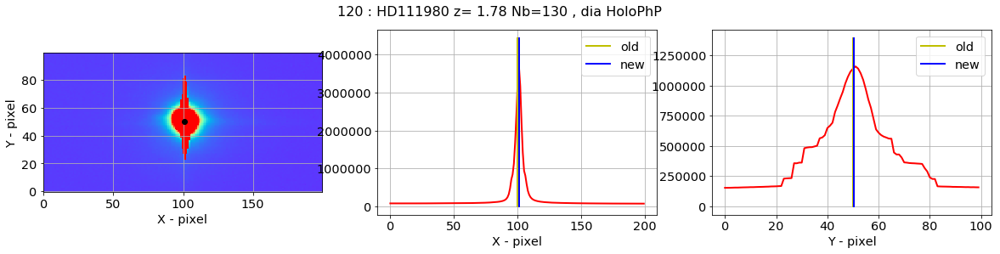

In [37]:
new_x_guess,new_y_guess=check_central_star(all_images,x_guess,y_guess,all_titles,all_filt,Dx=100,Dy=50)

### Check corrections of the center

In [38]:
dx_guess=new_x_guess-x_guess
dy_guess=new_y_guess-y_guess

Text(0.5,0,'dy - pixel')

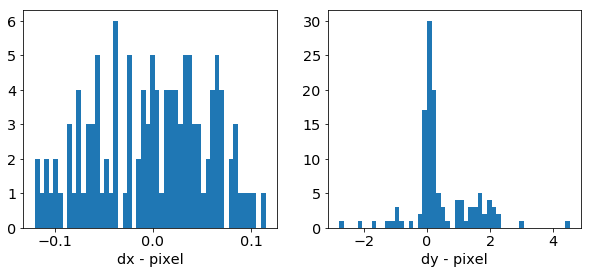

In [39]:
f, (ax1, ax2) = plt.subplots(1,2, figsize=(10,4))
ax1.hist(dx_guess,bins=50);
ax1.set_xlabel("dx - pixel")
ax2.hist(dy_guess,bins=50);
ax2.set_xlabel("dy - pixel")

In [40]:
x_guess=new_x_guess
y_guess=new_y_guess

## Save x_guess, y_guess in a file

In [41]:
ar = {'x_guess' : x_guess, 'y_guess' : y_guess}
df = pd.DataFrame(ar)

In [42]:
df.head()

,x_guess,y_guess
0,755.870346,646.137105
1,757.195929,646.880298
2,846.472796,587.928638
3,755.294009,648.305622
4,754.511578,645.646621


In [43]:
df.tail()

,x_guess,y_guess
116,697.910551,639.750000
117,786.689280,580.677930
118,785.310918,580.127368
119,695.899025,642.090344
120,693.889028,641.400451


In [44]:
df.describe()

,x_guess,y_guess
count,121.000000,121.000000
mean,772.421639,609.128995
std,48.675719,30.625118
min,693.889028,573.249555
25%,730.156989,577.808836
50%,755.870346,633.549629
75%,818.903318,638.117674
max,846.472796,648.305622


In [45]:
df.to_csv('x_y_guess.csv')

In [46]:
df

,x_guess,y_guess
0,755.870346,646.137105
1,757.195929,646.880298
2,846.472796,587.928638
3,755.294009,648.305622
4,754.511578,645.646621
5,845.599107,586.637387
6,843.797878,586.083968
7,754.880539,646.425009
8,754.937172,645.307645
9,843.794778,585.400580


In [47]:
df.to_csv('x_y_guess.csv')

In [48]:
writer = pd.ExcelWriter('x_y_guess.xlsx')
sheet_name=object_name+'_'+date
df.to_excel(writer,sheet_name)
writer.save()

## Finally cut image

- before rotation

- cut the image around the spectra
- the width in Y is DeltaY=100 pixel above and down

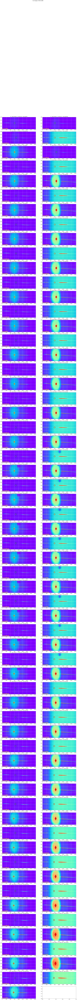

In [49]:
DeltaY=[200]*len(all_images) # put to 200 because background goes far
DeltaX=[2000]*len(all_images)  # must be very large to have correct x positions

images_raw=ShowCenterImages(x_guess,y_guess,DeltaX,DeltaY,all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000,target_pos=np.array([x_guess,y_guess]).T)
figfilename=os.path.join(dir_top_images,'cut_images.pdf')
plt.savefig(figfilename)   

## Save cut images
------------------------

- save the series of cut images called **images_raw** in a file


In [50]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^%s_(.*)' % tag,short_infilename)
    short_outfilename='cutimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)
    
for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_raw[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)